<h1 style="color:#ffc0cb;font-size:70px;font-family:Georgia;text-align:center;"><strong>Book Recommender System: Model</strong></h1>

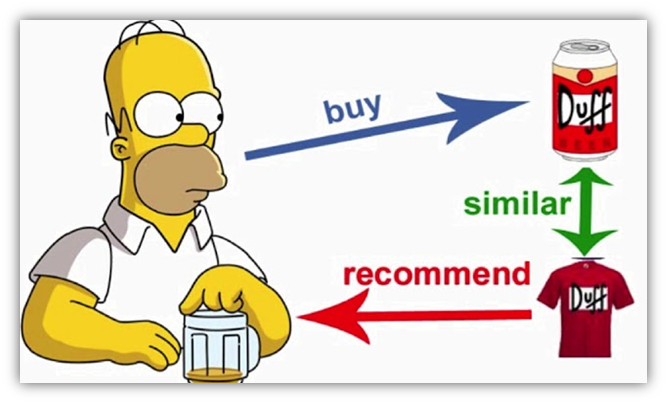

<h1 style="color:#ffc0cb;font-size:40px;font-family:Georgia;text-align:center;"><strong> 📜 Table of Content</strong></h1>

### 4. [Types of Recommendation Engines](#4)

<br>

### 5. [Feature Engneering](#5)

<br>

#### 5.2 [Data Retrieving](#5.2)

<br>

#### 5.3 [Select the columns](#5.3)

<br>

#### 5.4 [Encoding](#5.4)

<br>

#### 5.5 [Splitting data](#5.5)

<br>

#### 5.6 [Preprocessing data](#5.6)

<br>

#### 5.7 [Transfer from text to vector](#5.7)

<br>

### 6. [Build a Recommender System](#6)

<br>

#### 6.1 [Collaborative Filtering Recommender](#6.1)

<br>


##### 6.1.1 [Memory Based Collaborative Filtering Recommender](#6.1.1)


<br>

##### 6.1.2 [Model Based Collaborative Filtering Recommender](#6.1.2)

<br>

#### 6.2 [Content Based Recommender](#6.2)

<br>


#### 6.3 [Popularity Recommender](#6.3)

<br>

#### 6.4 [Random Recommender](#6.4)

<br>

#### 6.5 [Evaluating Model](#6.5)


<a id="5"></a>
<h1 style="color:#ffc0cb;font-size:40px;font-family:Georgia;text-align:center;"><strong> 🛠 5. Feature Engineering</strong></h1>

<a id="5.1"></a>
# 5.1 Importing Necessary Libraries and datasets:
***

In [1]:
!pip install ray
!pip install -U "ray[tune]"  # installs Ray + dependencies for Ray Tune
!pip install -U "ray[rllib]"  # installs Ray + dependencies for Ray RLlib
!pip install -U "ray[serve]"  # installs Ray + dependencies for Ray Serve

In [2]:
import sys
! pip install nltk
# !{sys.executable} -m pip -q install scikit-surprise
# !{sys.executable} -m pip -q install category_encoders
# !pip install recmetrics

#Load pandas library:
import pandas as pd
# round the data in the correlation matrix
import numpy as np
import math
import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt
palette = sns.color_palette("RdBu", 10)

#This library is for encoding
import category_encoders as ce
from sklearn.preprocessing import LabelEncoder
#Preprocessing
from sklearn.preprocessing import RobustScaler
from sklearn.decomposition import PCA
#This library is for the model base collaborative filtering recommender
from surprise import SVD, NMF, SVDpp
#this is for puting the data to the model
from surprise import Dataset, Reader
#this is for hyperparameter tuning
from surprise.model_selection import cross_validate, train_test_split, GridSearchCV
import recmetrics

#This is libraries for the content based
import joblib
from joblib import parallel_backend # added line.
from ray.util.joblib import register_ray # added line.
register_ray() # added line.
#This is for convert words to vectors
import re
import nltk
from nltk.stem.wordnet import WordNetLemmatizer
from nltk.corpus import stopwords
nltk.download('popular')
nltk.download("punkt")

# ignore DeprecationWarning Eror Messages
import warnings
warnings.filterwarnings('ignore')

#The pickle is for saving model
import pickle

register_ray()

[nltk_data] Downloading collection 'popular'
[nltk_data]    | 
[nltk_data]    | Downloading package cmudict to
[nltk_data]    |     /Users/huynhchau/nltk_data...
[nltk_data]    |   Package cmudict is already up-to-date!
[nltk_data]    | Downloading package gazetteers to
[nltk_data]    |     /Users/huynhchau/nltk_data...
[nltk_data]    |   Package gazetteers is already up-to-date!
[nltk_data]    | Downloading package genesis to
[nltk_data]    |     /Users/huynhchau/nltk_data...
[nltk_data]    |   Package genesis is already up-to-date!
[nltk_data]    | Downloading package gutenberg to
[nltk_data]    |     /Users/huynhchau/nltk_data...
[nltk_data]    |   Package gutenberg is already up-to-date!
[nltk_data]    | Downloading package inaugural to
[nltk_data]    |     /Users/huynhchau/nltk_data...
[nltk_data]    |   Package inaugural is already up-to-date!
[nltk_data]    | Downloading package movie_reviews to
[nltk_data]    |     /Users/huynhchau/nltk_data...
[nltk_data]    |   Package movie_

<a id="5.2"></a>
# 📲 5.2 Data Retrieving:
***
Since I have the popularity recommender, content-based and collaborating fitler. In the popular recommender we do not concern about the explicit or implicit feedback. So we will load both of dataset including all rating valules and explicit rating values.

> **Sample book_user_explicit_rating Dataset**

In [3]:
## Importing the datasets
ex_rating_df = pd.read_csv("Data/Cleaned_Data/book_user_explicit_rating_cleaned.csv", encoding='utf-8')
ex_rating_df = ex_rating_df.loc[:, ~ex_rating_df.columns.str.contains('^index')]
ex_rating_df = ex_rating_df.loc[:, ~ex_rating_df.columns.str.contains('^Unnamed')]


ex_rating_df.columns = ex_rating_df.columns.str.replace(' ', '') #strip the extra-whitespaces out

print("The shape of the ORGINAL data is (row, column):", str(ex_rating_df.shape))
ex_rating_df = ex_rating_df.replace({"^\W+$":""}, regex=True)  


# drop Unnamed, it is just a number given to identify each house
ex_rating_df.head(3)

The shape of the ORGINAL data is (row, column): (151324, 12)


,User_ID,ISBN,Book_Rating,Book_Title,Book_Author,Publication_year,Publisher,Image_URL,Unique_ISBN,Age,Country,Age_Range
0,276747,0060517794,9,LITTLE ALTARS EVERYWHERE,REBECCA WELLS,2003.0,HARPERTORCH,HTTP://IMAGES.AMAZON.COM/IMAGES/P/0060517794.0...,0060517794,25.0,USA,18-36
1,276747,0671537458,9,WAITING TO EXHALE,TERRY MCMILLAN,1995.0,POCKET,HTTP://IMAGES.AMAZON.COM/IMAGES/P/0671537458.0...,0671537458,25.0,USA,18-36
2,276747,0679776818,8,BIRDSONG: A NOVEL OF LOVE AND WAR,SEBASTIAN FAULKS,1997.0,VINTAGE BOOKS USA,HTTP://IMAGES.AMAZON.COM/IMAGES/P/0679776818.0...,0679776818,25.0,USA,18-36


> **Sample book_cleaned Dataset**

In [4]:
## Importing the datasets
book = pd.read_csv("Data/Cleaned_Data/book_cleaned.csv", delimiter=',', skipinitialspace = True, encoding='cp1252', on_bad_lines='skip')
book = book.loc[:, ~book.columns.str.contains('^Unnamed')]

book.columns = book.columns.str.replace(' ', '') #strip the extra-whitespaces out

print("The shape of the ORGINAL data is (row, column):", str(book.shape))

# drop Unnamed, it is just a number given to identify each house
book.head(3)

The shape of the ORGINAL data is (row, column): (266735, 6)


,ISBN,Book_Title,Book_Author,Publication_year,Publisher,Image_URL
0,0195153448,CLASSICAL MYTHOLOGY,MARK P. O. MORFORD,2002,OXFORD UNIVERSITY PRESS,HTTP://IMAGES.AMAZON.COM/IMAGES/P/0195153448.0...
1,0002005018,CLARA CALLAN,RICHARD BRUCE WRIGHT,2001,HARPERFLAMINGO CANADA,HTTP://IMAGES.AMAZON.COM/IMAGES/P/0002005018.0...
2,0060973129,DECISION IN NORMANDY,CARLO D'ESTE,1991,HARPERPERENNIAL,HTTP://IMAGES.AMAZON.COM/IMAGES/P/0060973129.0...


> **Sample rating_cleaned Dataset**

In [5]:
## Importing the datasets
rating = pd.read_csv("Data/Cleaned_Data/rating_cleaned.csv", delimiter=',', skipinitialspace = True, encoding='cp1252', on_bad_lines='skip')
rating = rating.loc[:, ~rating.columns.str.contains('^Unnamed')]

rating.columns = rating.columns.str.replace(' ', '') #strip the extra-whitespaces out

print("The shape of the ORGINAL data is (row, column):", str(rating.shape))

# drop Unnamed, it is just a number given to identify each house
rating.head(3)

The shape of the ORGINAL data is (row, column): (569976, 3)


,User_ID,ISBN,Book_Rating
0,276746,0425115801,0
1,276746,0449006522,0
2,276746,0553561618,0


<a id="5.3"></a>
# 5.3 Select the columns
***

<a id="5.3.1"></a>
## 5.3.1 Select the columns for Collaborative Filtering Recommender
***

In [6]:
test = ex_rating_df.drop(columns=['Image_URL','Unique_ISBN'])
test.head()

,User_ID,ISBN,Book_Rating,Book_Title,Book_Author,Publication_year,Publisher,Age,Country,Age_Range
0,276747,0060517794,9,LITTLE ALTARS EVERYWHERE,REBECCA WELLS,2003.0,HARPERTORCH,25.0,USA,18-36
1,276747,0671537458,9,WAITING TO EXHALE,TERRY MCMILLAN,1995.0,POCKET,25.0,USA,18-36
2,276747,0679776818,8,BIRDSONG: A NOVEL OF LOVE AND WAR,SEBASTIAN FAULKS,1997.0,VINTAGE BOOKS USA,25.0,USA,18-36
3,276762,0380711524,5,SEE JANE RUN,JOY FIELDING,1992.0,AVON,25.0,GERMANY,18-36
4,276772,0553572369,7,PAY DIRT (MRS. MURPHY MYSTERIES (PAPERBACK)),RITA MAE BROWN,1996.0,BANTAM,34.0,GERMANY,18-36


In [7]:
ex_rating_df = ex_rating_df.drop(columns=['Image_URL','ISBN'])
ex_rating_df.head()

,User_ID,Book_Rating,Book_Title,Book_Author,Publication_year,Publisher,Unique_ISBN,Age,Country,Age_Range
0,276747,9,LITTLE ALTARS EVERYWHERE,REBECCA WELLS,2003.0,HARPERTORCH,0060517794,25.0,USA,18-36
1,276747,9,WAITING TO EXHALE,TERRY MCMILLAN,1995.0,POCKET,0671537458,25.0,USA,18-36
2,276747,8,BIRDSONG: A NOVEL OF LOVE AND WAR,SEBASTIAN FAULKS,1997.0,VINTAGE BOOKS USA,0679776818,25.0,USA,18-36
3,276762,5,SEE JANE RUN,JOY FIELDING,1992.0,AVON,0380711524,25.0,GERMANY,18-36
4,276772,7,PAY DIRT (MRS. MURPHY MYSTERIES (PAPERBACK)),RITA MAE BROWN,1996.0,BANTAM,0553572369,34.0,GERMANY,18-36


<a id="5.3.2"></a>
## 5.3.2 Select the columns 
***

For the collaborative filtering recommender, we will use the following columns:

In [8]:
book_df_CF = ex_rating_df[['Book_Author','Unique_ISBN','Book_Title','Publication_year']]

In [9]:
ex_rating_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 151324 entries, 0 to 151323
Data columns (total 10 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   User_ID           151324 non-null  int64  
 1   Book_Rating       151324 non-null  int64  
 2   Book_Title        151324 non-null  object 
 3   Book_Author       151324 non-null  object 
 4   Publication_year  151324 non-null  float64
 5   Publisher         151324 non-null  object 
 6   Unique_ISBN       151324 non-null  object 
 7   Age               151324 non-null  float64
 8   Country           151324 non-null  object 
 9   Age_Range         151324 non-null  object 
dtypes: float64(2), int64(2), object(6)
memory usage: 11.5+ MB


<a id="5.4"></a>
# 5.4 Encoding
***

In [10]:
labelenc = LabelEncoder()

In [11]:
def label_encoding(df,param):
    df[param] = labelenc.fit_transform(df[param].values)
    df[param] = df[param].astype('category')

In [12]:
label_encoding(ex_rating_df, 'User_ID')
label_encoding(ex_rating_df, 'Unique_ISBN')
label_encoding(ex_rating_df, 'Publication_year')
label_encoding(ex_rating_df, 'Publisher')
label_encoding(ex_rating_df, 'Age_Range')
label_encoding(ex_rating_df, 'Book_Author')

In [13]:
enc_data = ex_rating_df[['User_ID','Unique_ISBN','Book_Rating']]

Preapare data for pca

In [14]:
pca_data = ex_rating_df[['User_ID','Unique_ISBN','Book_Rating','Publication_year','Publisher','Age_Range','Book_Author']]
prep_pca_data = pca_data[(pca_data['Book_Rating'] > 0) & (pca_data['Book_Rating'] < 10)] 

<a id="5.5"></a>
# 5.5 Splitting data
***

In [15]:
reader = Reader(rating_scale=(1, 10))
data = Dataset.load_from_df(enc_data[['User_ID', 'Unique_ISBN', 'Book_Rating']], reader)

In [16]:
trainset, testset = train_test_split(data, test_size=0.2)

<a id="5.6"></a>
# 5.6 Preprocessing data
***

In [17]:
# Drop duplicated Values
book_df_CF.drop_duplicates(inplace=True)
# Drop N.A. Values
book_df_CF.dropna(inplace=True)
book_df_CF = book_df_CF.reindex(np.random.permutation(book_df_CF.index))

<a id="5.7"></a>
# 5.7 Transfer from text to vector (Content_based):
***
Using NLP to extract the author and constructing a bag of words

## Extract corpus

In [18]:
lemmatizer = WordNetLemmatizer()
corpus =[]
for index, value in book_df_CF.iterrows():
# Needs to filter alphabetical word and lowering the case
  review = re.sub('[^a-zA-Z]',' ',book_df_CF.loc[index,'Book_Author'])
  review = review.lower()
  review = review.split()
  #Tokenize author and words
  review = [lemmatizer.lemmatize(word) for word in review if word not in set(stopwords.words('english'))]
  review = ' '.join(review)
  corpus.append(review)
    

## Inspect corpus

In [19]:
corpus

['jack kerouac',
 'char loving',
 'judy blume',
 'julie e czerneda',
 'mary higgins clark',
 'douglas coupland',
 'michael j nelson',
 'faye kellerman',
 'michael marshall',
 'john irving',
 'heidi e murkoff',
 'arthur conan doyle',
 'doris kearns goodwin',
 'carol adrienne',
 'william j bennett',
 'liza crihfield dalby',
 'judith mcnaught',
 'raymond e feist',
 'alisa kwitney',
 'reader digest',
 'alison weir',
 'steve perry',
 'james michael pratt',
 'orson scott card',
 'claudia black',
 'patricia cornwell',
 'clive barker',
 'jack higgins',
 'mark canter',
 'aphrodite jones',
 'sandra hill',
 'douglas adam',
 'anna quindlen',
 'elizabeth berg',
 'jill mccorkle',
 'richard adam',
 'benjamin hoff',
 'louis calaferte',
 'lawrence krauss',
 'beatrice spark',
 'daniel de foe',
 'dana stabenow',
 'mary higgins clark',
 'william shatner',
 'orson scott card',
 'jane green',
 'dan simmons',
 'clive cussler',
 'jostein gaarder',
 'robert rankin',
 'joan hess',
 'ian mcewan',
 'jerry spinell

## Check the length corpus

In [20]:
len(corpus)

15191

## Filter and leave only unique author in the corpus

In [21]:
corpus = np.unique(corpus)
len(corpus)

5009

## Convert words to vectors

In [22]:
#Ignoring stopwords (words with no semantics) from English and Portuguese (as we have a corpus with mixed languages)
from sklearn.feature_extraction.text import TfidfVectorizer
stopwords_list = stopwords.words('english') + stopwords.words('portuguese')

#Trains a model whose vectors size is 5000, composed by the main unigrams and bigrams found in the corpus, ignoring stopwords
#Common parameters for TFIDVectorizer:
tfid_vect = TfidfVectorizer(analyzer='word',
                     ngram_range=(1, 2),
                     min_df=0.003,
                     max_df=0.5,
                     max_features=5000,
                     stop_words=stopwords_list)

item_ids = book_df_CF['Unique_ISBN'].tolist()
tfidf_mat =''
with joblib.parallel_backend('ray'):
    tfidf_mat = tfid_vect.fit_transform(corpus)
tfidf_feature_names = tfid_vect.get_feature_names()
tfidf_mat

<5009x63 sparse matrix of type '<class 'numpy.float64'>'
	with 1885 stored elements in Compressed Sparse Row format>

In [23]:
tfidf_mat.shape

(5009, 63)

<a id="6"></a>
<h1 style="color:#ffc0cb;font-size:40px;font-family:Georgia;text-align:center;"><strong> 🤖 6. Build a Recommender System</strong></h1>

****

> - Collaborative Filtering Recommender
> - Content based Recommender
> - Population Recommender
> - Hybrid Recommender

<a id="6.1"></a>
# 6.1 Collaborative Filtering Recommender
***
Collaborative Filtering Recommender includes memory base Collaborative Filtering Recommender
Building machine learning algorithms to anticipate user ratings is part of the model-based approach. They use dimensionality reduction techniques to replace a large matrix with a lot of missing values with a much smaller matrix in a lower-dimensional space.

Memory-based algorithms use statistical approaches to compute predictions across the full dataset. They're split into two categories: user-item filtering and item-item filtering. The closest users or things are computed only using mathematical operations, such as Cosine similarity or Pearson correlation coefficients.



<a id="6.1.1"></a>
## 6.1.1 Memory Based Collaborative Filtering Recommender
***
I have to split the data set again since this data does not require to use library. 

In [24]:
from sklearn.model_selection import train_test_split
# Data
df_memory_based_CF = ex_rating_df[['User_ID', 'Unique_ISBN', 'Book_Rating']]
train_data, test_data = train_test_split(df_memory_based_CF, test_size=0.2, shuffle=False, random_state=0)

Now I need to create a user-item matrix. Since I have splitted the data into testing and training, I need to create two matrices. The training matrix contains 80% of the ratings and the testing matrix contains 20% of the ratings.

In [25]:
ex_rating_df['User_ID'] = ex_rating_df['User_ID'].astype('int') 
ex_rating_df['Unique_ISBN'] = ex_rating_df['Unique_ISBN'].astype('int') 

In [26]:
n_users = ex_rating_df['User_ID'].max()
n_book = ex_rating_df['Unique_ISBN'].max()

#Create two user-item matrices, one for training and another for testing
train_data_matrix = np.zeros((n_users, n_book))
for line in train_data.itertuples():
    train_data_matrix[line[1]-1, line[2]-1] = line[3]

test_data_matrix = np.zeros((n_users, n_book))
for line in test_data.itertuples():
    test_data_matrix[line[1]-1, line[2]-1] = line[3]

# Check their shape
print(train_data_matrix.shape)
print(test_data_matrix.shape)

(17510, 13606)
(17510, 13606)


In [27]:
from sklearn.metrics.pairwise import pairwise_distances

# User Similarity Matrix
user_correlation = 1 - pairwise_distances(train_data_matrix, metric='cosine')
user_correlation[np.isnan(user_correlation)] = 0
print(user_correlation[:4, :4])

[[1. 0. 0. 0.]
 [0. 1. 0. 0.]
 [0. 0. 1. 0.]
 [0. 0. 0. 1.]]


In [28]:
# Item Similarity Matrix
item_correlation = 1 - pairwise_distances(train_data_matrix.T, metric='cosine')
item_correlation[np.isnan(item_correlation)] = 0
print(item_correlation[:4, :4])

[[1. 0. 0. 0.]
 [0. 1. 0. 0.]
 [0. 0. 1. 0.]
 [0. 0. 0. 1.]]


In [29]:
# Function to predict ratings
def predict(ratings, similarity, type='user'):
    if type == 'user':
        mean_user_rating = ratings.mean(axis=1)
        # Use np.newaxis so that mean_user_rating has same format as ratings
        ratings_diff = (ratings - mean_user_rating[:, np.newaxis])
        pred = mean_user_rating[:, np.newaxis] + similarity.dot(ratings_diff) / np.array([np.abs(similarity).sum(axis=1)]).T
    elif type == 'item':
        pred = ratings.dot(similarity) / np.array([np.abs(similarity).sum(axis=1)])
    return pred

## Evaluation

In [30]:
from sklearn.metrics import mean_squared_error

# Function to calculate RMSE
def rmse(pred, actual):
    # Ignore nonzero terms.
    pred = pred[actual.nonzero()].flatten()
    actual = actual[actual.nonzero()].flatten()
    return np.sqrt(mean_squared_error(pred, actual))

In [31]:
# Predict ratings on the training data with both similarity score
user_prediction = predict(train_data_matrix, user_correlation, type='user')
item_prediction = predict(train_data_matrix, item_correlation, type='item')

# RMSE on the train data
print('User-based CF RMSE: ' + str(rmse(user_prediction, train_data_matrix)))
print('Item-based CF RMSE: ' + str(rmse(item_prediction, train_data_matrix)))

User-based CF RMSE: 6.878500325214696
Item-based CF RMSE: 6.933613787364209


In [32]:
rating['User_ID'] = rating['User_ID'].astype('string') 
book['ISBN'] = book['ISBN'].astype('string')

In [33]:
def recommend_book(predictions, userID, book, original_ratings, num_recommendations):
    
    # Get and sort the user's predictions
    user_row_number = userID - 1 # User ID starts at 1, not 0
    sorted_user_predictions = pd.DataFrame(predictions).reset_index(drop=True).iloc[user_row_number]
    
    # Get the user's data and merge in the book information.
    user_data = original_ratings[original_ratings.User_ID == (userID)]
    user_full = (user_data.merge(book, how = 'left', left_on = 'ISBN', right_on = 'ISBN').
                     sort_values(['Book_Rating'], ascending=False)
                 )

    print('User {0} has already rated {1} books.'.format(userID, user_full.shape[0]))
    print('Recommending highest {0} predicted ratings books not already rated.'.format(num_recommendations))
    
    # Recommend the highest predicted rating books that the user hasn't seen yet.
    recommendations = book[~book['ISBN'].isin(user_full['ISBN'])]
    recommendations = recommendations.merge(sorted_user_predictions, how = 'left',
               left_on = 'ISBN',
               right_on = sorted_user_predictions.index)
    recommendations = recommendations.rename(columns = {user_row_number: 'Predictions'})
    recommendations = recommendations.sort_values('Predictions', ascending = False)
    recommendations = recommendations.iloc[:num_recommendations, :-1]
                      

    return user_full, recommendations

In [34]:
already_rated, memory_predictions_result = recommend_book(user_prediction, 8, book, test, 10)

User 8 has already rated 1 books.
Recommending highest 10 predicted ratings books not already rated.


In [35]:
memory_predictions_result

,ISBN,Book_Title,Book_Author,Publication_year,Publisher,Image_URL
0,0195153448,CLASSICAL MYTHOLOGY,MARK P. O. MORFORD,2002,OXFORD UNIVERSITY PRESS,HTTP://IMAGES.AMAZON.COM/IMAGES/P/0195153448.0...
1,0060973129,DECISION IN NORMANDY,CARLO D'ESTE,1991,HARPERPERENNIAL,HTTP://IMAGES.AMAZON.COM/IMAGES/P/0060973129.0...
2,0374157065,FLU: THE STORY OF THE GREAT INFLUENZA PANDEMIC...,GINA BARI KOLATA,1999,FARRAR STRAUS GIROUX,HTTP://IMAGES.AMAZON.COM/IMAGES/P/0374157065.0...
3,0393045218,THE MUMMIES OF URUMCHI,E. J. W. BARBER,1999,W. W. NORTON &AMP; COMPANY,HTTP://IMAGES.AMAZON.COM/IMAGES/P/0393045218.0...
4,0399135782,THE KITCHEN GOD'S WIFE,AMY TAN,1991,PUTNAM PUB GROUP,HTTP://IMAGES.AMAZON.COM/IMAGES/P/0399135782.0...
5,0425176428,WHAT IF?: THE WORLD'S FOREMOST MILITARY HISTOR...,ROBERT COWLEY,2000,BERKLEY PUBLISHING GROUP,HTTP://IMAGES.AMAZON.COM/IMAGES/P/0425176428.0...
6,0671870432,PLEADING GUILTY,SCOTT TUROW,1993,AUDIOWORKS,HTTP://IMAGES.AMAZON.COM/IMAGES/P/0671870432.0...
7,0679425608,UNDER THE BLACK FLAG: THE ROMANCE AND THE REAL...,DAVID CORDINGLY,1996,RANDOM HOUSE,HTTP://IMAGES.AMAZON.COM/IMAGES/P/0679425608.0...
8,074322678X,WHERE YOU'LL FIND ME: AND OTHER STORIES,ANN BEATTIE,2002,SCRIBNER,HTTP://IMAGES.AMAZON.COM/IMAGES/P/074322678X.0...
9,0771074670,NIGHTS BELOW STATION STREET,DAVID ADAMS RICHARDS,1988,EMBLEM EDITIONS,HTTP://IMAGES.AMAZON.COM/IMAGES/P/0771074670.0...


<a id="6.1.2"></a>
# 6.1.2 Model Based Collaborative Filtering Recommender
***

<a id="6.1.2.a"></a>
## 6.1.2.a Comparing the SVD and NMF models
****
Singular Value Decomposition (SVD) and Non-negative Matrix Factorization (NMF) are matrix factorization techniques used for dimensionality reduction. Surprise package provides implementation of those algorithms.

It's clear that for the given dataset much better results can be obtained with SVD approach - both in terms of accuracy and training / testing time.

## SVD:

In [36]:
# #intialise the model
# model_svd = SVD()
# #fit model and using cross validation for evaluating
# cv_results_svd = cross_validate(model_svd, data, cv=3)
# #Demonstrate the CV result
# pd.DataFrame(cv_results_svd).mean()

## NMF

In [37]:
# #intialise the model
# model_nmf = NMF()
# #fit model and using cross validation for evaluating
# cv_results_nmf = cross_validate(model_nmf, data, cv=3)
# #Demonstrate the CV result
# pd.DataFrame(cv_results_nmf).mean()

## SVDpp:

In [38]:
# #intialise the model
# model_SVDpp = SVDpp()
# #fit model and using cross validation for evaluating
# cv_results_nmf = cross_validate(model_SVDpp, data, cv=3)
# #Demonstrate the CV result
# pd.DataFrame(cv_results_nmf).mean()

### ---------> OBSERVATION
****
The SVD has a better performance so that it is choose for the representer algorithm of the model base Collaborative Filtering Recommender.

**Paraphase again**

Grid Search Cross Validation computes accuracy metrics for an algorithm on various combinations of parameters, over a cross-validation procedure. It's useful for finding the best configuration of parameters.

It is used to find the best setting of parameters:

> - n_factors - the number of factors
> - n_epochs - the number of iteration of the SGD procedure
> - lr_all - the learning rate for all parameters
> - reg_all - the regularization term for all parameters

As a result, regarding the majority of parameters, the default setting is the most optimal one. The improvement obtained with Grid Search is very small.

<a id="6.1.2.b"></a>
## 6.1.2.b Hyperparamter tuning for SVD
****

In [39]:
# #initiliase the param for grid search
# params = {'n_epochs': [50, 70, 100],
#           'n_factors': [80,100,120],
#           'lr_all': [0.002, 0.005],
#           'reg_all': [0.2, 0.4, 0.6]
#          }

# gs = GridSearchCV(SVD, params, measures=['rmse', 'mae'], cv=3)
# gs.fit(data)

# print(gs.best_score['rmse'])
# print(gs.best_params['rmse'])

In [40]:
# svd = SVD(n_factors=80, n_epochs=100, lr_all=0.002, reg_all=0.2)

In [41]:
# create an iterator object with write permission - model.pkl
# with open('CF_SVD', 'wb') as files:
#     pickle.dump(svd, files)

<a id="6.1.2.c"></a>
## 6.1.2.c Retrain
****

In [43]:
svd = SVD(n_factors=80, n_epochs=100, lr_all=0.002, reg_all=0.2)
svd.fit(trainset)

predictions = svd.test(testset)
predictions = pd.DataFrame(predictions)
predictions.drop("details", inplace=True, axis=1)
predictions.columns = ['User_ID', 'ISBN', 'Rating', 'svd_predictions']
predictions.head()


,User_ID,ISBN,Rating,svd_predictions
0,6011,6713,9.0,8.544996
1,5258,3278,7.0,7.471994
2,2685,3697,6.0,6.923433
3,5624,4307,9.0,9.446319
4,11801,9105,10.0,8.285603


In [44]:
predictions['memory_predictions'] = predictions['svd_predictions']

### ------------> OBSERVATION
***
The SVD model outperformed the memory based model significantly.

## Get recommendation for valuating

In [45]:
#create model (matrix of predicted values)
memory_predictions_result = predictions.pivot_table(index='User_ID', columns='ISBN', values='memory_predictions').fillna(0)

#create model (matrix of predicted values)
svd_predictions = predictions.pivot_table(index='User_ID', columns='ISBN', values='svd_predictions').fillna(0)


In [46]:
def get_users_predictions(user_id, n, model):
    recommended_items = pd.DataFrame(model.loc[user_id])
    recommended_items.columns = ["pred"]
    recommended_items = recommended_items.sort_values('pred', ascending=False)    
    recommended_items = recommended_items.head(n)
    return recommended_items.index.tolist()

In [47]:
get_users_predictions(13640, 10, svd_predictions)

[10717, 1534, 9105, 6568, 11008, 4168, 2221, 8774, 4175, 5446]

In [48]:
predictions = predictions.copy().groupby('User_ID', as_index=False)['ISBN'].agg({'actual': (lambda x: list(set(x)))})

## Result for SVD and actual

In [49]:
#Get number of user in the prediction
predictions = predictions.set_index("User_ID")


In [50]:
# make recommendations for all members in the test data
svd_recs = [] = []
for user in predictions.index:
    svd_result = get_users_predictions(user, 10, svd_predictions)
    svd_recs.append(svd_result)
        
predictions['svd_predictions'] = svd_recs
predictions.head()

,actual,svd_predictions
User_ID,,
3,[3637],"[3637, 0, 8900, 8892, 8894, 8895, 8896, 8897, ..."
6,[2211],"[2211, 0, 8900, 8892, 8894, 8895, 8896, 8897, ..."
8,[7193],"[7193, 0, 8889, 8892, 8894, 8895, 8896, 8897, ..."
9,[2427],"[2427, 8889, 8892, 8894, 8895, 8896, 8897, 889..."
10,[4402],"[4402, 0, 8901, 8894, 8895, 8896, 8897, 8898, ..."


## Result for Memory Based and actual

In [51]:
# make recommendations for all members in the test data
memory_recs = [] = []

for user in predictions.index:
    memory_based = get_users_predictions(user, 10, memory_predictions_result)
    memory_recs.append(memory_based)
        
predictions['memory_predictions'] = memory_recs
predictions.head()

,actual,svd_predictions,memory_predictions
User_ID,,,
3,[3637],"[3637, 0, 8900, 8892, 8894, 8895, 8896, 8897, ...","[3637, 0, 8900, 8892, 8894, 8895, 8896, 8897, ..."
6,[2211],"[2211, 0, 8900, 8892, 8894, 8895, 8896, 8897, ...","[2211, 0, 8900, 8892, 8894, 8895, 8896, 8897, ..."
8,[7193],"[7193, 0, 8889, 8892, 8894, 8895, 8896, 8897, ...","[7193, 0, 8889, 8892, 8894, 8895, 8896, 8897, ..."
9,[2427],"[2427, 8889, 8892, 8894, 8895, 8896, 8897, 889...","[2427, 8889, 8892, 8894, 8895, 8896, 8897, 889..."
10,[4402],"[4402, 0, 8901, 8894, 8895, 8896, 8897, 8898, ...","[4402, 0, 8901, 8894, 8895, 8896, 8897, 8898, ..."


<a id="6.2"></a>
# 6.2 Content Based Recommender
***
After training the model for recommending to the users with the similiar behaviour or more specific have the related rating points. The content base is also a good model to consider since our recommender system is for books so that the content based recommender system is a good choice
****
## Sigmoid Kernel

In [52]:
from sklearn.metrics.pairwise import sigmoid_kernel
#Compute Sigmoid kernel
with joblib.parallel_backend('ray'):
    #Can be tune with gamma
    sgm = sigmoid_kernel(tfidf_mat, tfidf_mat)

In [53]:
#Inspect the sgm data
sgm[0]

array([0.76159416, 0.76159416, 0.76159416, ..., 0.76159416, 0.76159416,
       0.76159416])

## Display some title

In [54]:
indices = pd.Series(book_df_CF.index,index = book_df_CF['Book_Title'])

In [55]:
indices

Book_Title
ON THE ROAD (PENGUIN CLASSICS)                                        33987
KNITTING JOURNAL                                                      62968
IGGIE'S HOUSE                                                         13418
BEHOLDER'S EYE (WEB SHIFTERS)                                         26848
REMEMBER ME                                                           12378
                                                                      ...  
COME BACK TO ME                                                        5333
THE DEMON-HAUNTED WORLD: SCIENCE AS A CANDLE IN THE DARK              28246
SEABISCUIT: AN AMERICAN LEGEND                                          365
THE MYSTERY OF THE IVORY CHARM (NANCY DREW MYSTERY STORIES, NO 13)    54294
VIRUS                                                                 36036
Length: 15191, dtype: int64

In [56]:
indices['THE SMOKE RING']

36368

## Recommender Function

In [57]:
def give_rec (title, sig = sgm):
  indices = pd.Series(book_df_CF.index, index = book_df_CF['Book_Title']).drop_duplicates()
  i = indices[title]
  arr = []
  #Get the pairwise similarity
  sgm_scores = list(enumerate(sig[i]))

  #Sort the books
  sgm_scores = sorted(sgm_scores, key = lambda x: x[1], reverse = True)

  #Score the 10 most similar books 
  sgm_scores = sgm_scores [1:11]
  book_indices = [j[0] for j in sgm_scores]
  # book_indices
  return book_df_CF['Book_Title'].iloc[book_indices]

In [58]:
CB_predictions_result = give_rec('ANGEL OF DARKNESS (KEY BOOKS)')

In [59]:
print(CB_predictions_result)

62968                                     KNITTING JOURNAL
13418                                        IGGIE'S HOUSE
26848                        BEHOLDER'S EYE (WEB SHIFTERS)
12378                                          REMEMBER ME
2241                                            MICROSERFS
13143                      MIKE NELSON'S MIND OVER MATTERS
67045    FALSE PROPHET: A PETER DECKER/RINA LAZARUS NOV...
11504                                        THE STRAW MEN
6770                       GOTTES WERK UND TEUFELS BEITRAG
3290     WHAT TO EXPECT WHEN YOU'RE EXPECTING, THIRD ED...
Name: Book_Title, dtype: object


<a id="6.3"></a>
# 6.3 Popularity Recommender
***
Creating a simple popularity recommender to demonstrate recommender metrics in action. The popularity recommender simply recommends the top 10 books to every user.

In [60]:
#make recommendations for all members in the test data
popularity_recs = ex_rating_df.Unique_ISBN.value_counts().head(10).index.tolist()

pop_recs = []
for user in predictions.index:
    pop_predictions = popularity_recs
    pop_recs.append(pop_predictions)
        
predictions['pop_predictions'] = pop_recs
predictions.head()

,actual,svd_predictions,memory_predictions,pop_predictions
User_ID,,,,
3,[3637],"[3637, 0, 8900, 8892, 8894, 8895, 8896, 8897, ...","[3637, 0, 8900, 8892, 8894, 8895, 8896, 8897, ...","[2157, 4380, 12156, 2221, 1433, 1791, 5205, 15..."
6,[2211],"[2211, 0, 8900, 8892, 8894, 8895, 8896, 8897, ...","[2211, 0, 8900, 8892, 8894, 8895, 8896, 8897, ...","[2157, 4380, 12156, 2221, 1433, 1791, 5205, 15..."
8,[7193],"[7193, 0, 8889, 8892, 8894, 8895, 8896, 8897, ...","[7193, 0, 8889, 8892, 8894, 8895, 8896, 8897, ...","[2157, 4380, 12156, 2221, 1433, 1791, 5205, 15..."
9,[2427],"[2427, 8889, 8892, 8894, 8895, 8896, 8897, 889...","[2427, 8889, 8892, 8894, 8895, 8896, 8897, 889...","[2157, 4380, 12156, 2221, 1433, 1791, 5205, 15..."
10,[4402],"[4402, 0, 8901, 8894, 8895, 8896, 8897, 8898, ...","[4402, 0, 8901, 8894, 8895, 8896, 8897, 8898, ...","[2157, 4380, 12156, 2221, 1433, 1791, 5205, 15..."


<a id="6.4"></a>
# 6.4 Random Recommender
***
Creating a simple random recommender to demonstrate recommender metrics in action. The random recommender simply recommends 10 random books to every user.

In [61]:
#make recommendations for all members in the test data

ran_recs = []
for user in predictions.index:
    random_predictions = ex_rating_df.Unique_ISBN.sample(10).values.tolist()
    ran_recs.append(random_predictions)
        
predictions['random_predictions'] = ran_recs
predictions.head()

,actual,svd_predictions,memory_predictions,pop_predictions,random_predictions
User_ID,,,,,
3,[3637],"[3637, 0, 8900, 8892, 8894, 8895, 8896, 8897, ...","[3637, 0, 8900, 8892, 8894, 8895, 8896, 8897, ...","[2157, 4380, 12156, 2221, 1433, 1791, 5205, 15...","[11112, 4847, 3720, 5258, 9164, 2492, 11701, 2..."
6,[2211],"[2211, 0, 8900, 8892, 8894, 8895, 8896, 8897, ...","[2211, 0, 8900, 8892, 8894, 8895, 8896, 8897, ...","[2157, 4380, 12156, 2221, 1433, 1791, 5205, 15...","[12291, 4948, 4917, 8048, 13606, 8757, 7968, 9..."
8,[7193],"[7193, 0, 8889, 8892, 8894, 8895, 8896, 8897, ...","[7193, 0, 8889, 8892, 8894, 8895, 8896, 8897, ...","[2157, 4380, 12156, 2221, 1433, 1791, 5205, 15...","[7068, 2492, 1446, 4299, 4633, 7697, 12598, 60..."
9,[2427],"[2427, 8889, 8892, 8894, 8895, 8896, 8897, 889...","[2427, 8889, 8892, 8894, 8895, 8896, 8897, 889...","[2157, 4380, 12156, 2221, 1433, 1791, 5205, 15...","[8301, 9586, 8571, 7351, 11527, 12592, 7215, 7..."
10,[4402],"[4402, 0, 8901, 8894, 8895, 8896, 8897, 8898, ...","[4402, 0, 8901, 8894, 8895, 8896, 8897, 8898, ...","[2157, 4380, 12156, 2221, 1433, 1791, 5205, 15...","[2377, 2948, 13437, 2693, 5753, 27, 2842, 1165..."


<a id="6.5"></a>
# 6.5 Evaluating Model:
***
In our recommender system, we want to focus on not only the similarity but also the coverage, the novelty values. First of all, the system try to have the similarity based on the customer preference, however, abformentioned there is a long tail problem, so that we also care about which algorithm can solve this problem more effectively, so that the coverage is concerned. Additionally, the customer also want to explore new things so that the novelty is also calculated. Moreover, we have already calculated the rsme and mae values for each system so we will not recalculate them. 

## Recall

In [62]:
actual = predictions.actual.values.tolist()
svd_predictions = predictions.svd_predictions.values.tolist()
memory_predictions = predictions.memory_predictions.values.tolist()
pop_predictions = predictions.pop_predictions.values.tolist()
random_predictions = predictions.random_predictions.values.tolist()

In [63]:
pop_mark = []
for K in np.arange(1, 11):
    pop_mark.extend([recmetrics.mark(actual, pop_predictions, k=K)])
pop_mark

[0.0038813725497885503,
 0.00502472245234079,
 0.0057970086559606575,
 0.006358356474551648,
 0.006820608749670871,
 0.007202427752666395,
 0.007474681852291205,
 0.007766662224732253,
 0.008000138903227002,
 0.008152614706873737]

In [64]:
random_mark = []
for K in np.arange(1, 11):
    random_mark.extend([recmetrics.mark(actual, random_predictions, k=K)])
random_mark

[0.00012862887676967993,
 0.00018267534358700624,
 0.0002484006102671995,
 0.00031867476953491357,
 0.0004158763340146139,
 0.00048516830464520627,
 0.0005203454890539225,
 0.000545995519351945,
 0.0005729203740045063,
 0.0006032384281202798]

In [65]:
svd_mark = []
for K in np.arange(1, 11):
    svd_mark.extend([recmetrics.mark(actual, svd_predictions, k=K)])
svd_mark


[0.6571296181414468,
 0.8294798609730276,
 0.8947899451531456,
 0.9279400557751741,
 0.947852684989171,
 0.9603086954624637,
 0.9689636813117274,
 0.9749980849667846,
 0.9795699204512915,
 0.982973904891894]

In [66]:
mem_mark = []
for K in np.arange(1, 11):
    mem_mark.extend([recmetrics.mark(actual, memory_predictions, k=K)])
mem_mark

[0.6571296181414468,
 0.8294798609730276,
 0.8947899451531456,
 0.9279400557751741,
 0.947852684989171,
 0.9603086954624637,
 0.9689636813117274,
 0.9749980849667846,
 0.9795699204512915,
 0.982973904891894]

### ------------> OBSERVATION
***
As expected, both of the collaborative filtering methods have the highest recall score. It can be explained that the popularity and the random algorithm just suggest the most popular and any books randomly, hence, the similarity is not high. Meanwhile, 2 collabroative filtering methods calculate the relationship between the users and itemn so that the recall point are high.

## Mark Plot
***
The mean of the average precision at K (APK) measure over all instances in the dataset is called Mean Average Precision at K. APK is a popular measure for retrieving information. The average relevance scores of a collection of the top-K documents provided in response to a query are measured by APK.

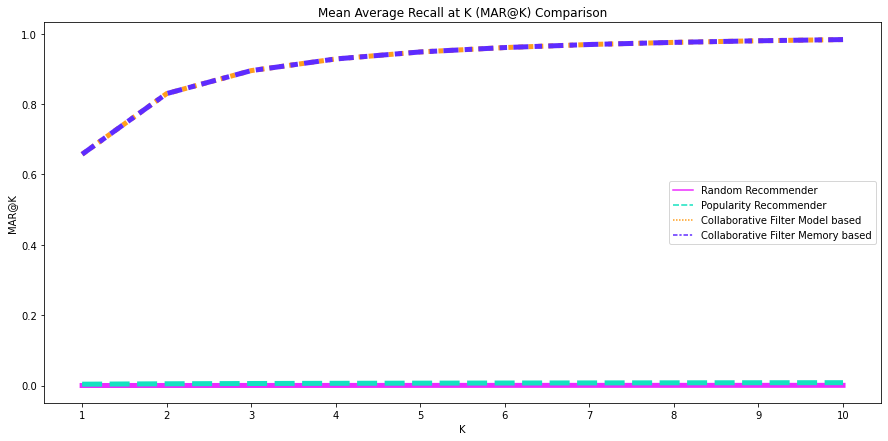

In [67]:
mark_scores = [random_mark, pop_mark, svd_mark, mem_mark]
index = range(1,10+1)
names = ['Random Recommender', 'Popularity Recommender', 'Collaborative Filter Model based', 'Collaborative Filter Memory based']

fig = plt.figure(figsize=(15, 7))
recmetrics.mark_plot(mark_scores, model_names=names, k_range=index)

### ------------> OBSERVATION
***
According the the recall point the MAR@K point of the Collaborative Filtering is the highest, meanwhile, the popularity and the random recsys is the lowest.

## Coverage

In [68]:
catalog = rating.ISBN.unique().tolist()
random_coverage = recmetrics.prediction_coverage(ran_recs, catalog)
pop_coverage = recmetrics.prediction_coverage(pop_recs, catalog)
svd_coverage = recmetrics.prediction_coverage(svd_recs, catalog)
mem_coverage = recmetrics.prediction_coverage(memory_recs, catalog)

In [69]:
# N=100 observed recommendation lists
random_cat_coverage = recmetrics.catalog_coverage(ran_recs, catalog, 100)
pop_cat_coverage = recmetrics.catalog_coverage(pop_recs, catalog, 100)
svd_cat_coverage = recmetrics.catalog_coverage(svd_recs, catalog, 100)
mem_coverage = recmetrics.catalog_coverage(memory_recs, catalog, 100)

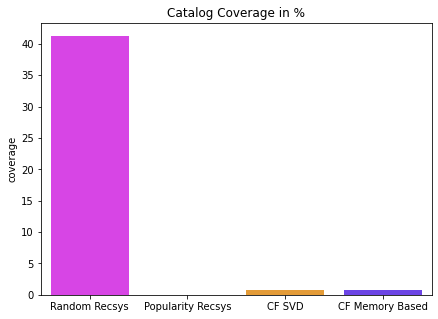

In [70]:
# plot of prediction coverage
coverage_scores = [random_coverage, pop_coverage, svd_cat_coverage, mem_coverage]
model_names = ['Random Recsys', 'Popularity Recsys', 'CF SVD', 'CF Memory Based']

fig = plt.figure(figsize=(7, 5))
recmetrics.coverage_plot(coverage_scores, model_names)

### ------------> OBSERVATION
***
> - As expected, the random algorithm has the highest point of Coverage, and the population has the lowest coverage point.
Since the random recsys make suggestion randomly, while the population only recommend the most populated book in the dataset. 
> - Suprisingly, both of the Collaborative Filtering have such a low coverage point. It may be because we did not balance the rating and book class properly before fitting it to the model.

## Novelty

In [71]:
nov = ex_rating_df.Unique_ISBN.value_counts()
pop = dict(nov)

users = ex_rating_df.User_ID.unique().tolist()

In [72]:
random_novelty,random_mselfinfo_list = recmetrics.novelty(ran_recs, pop, len(users), 10)
pop_novelty,pop_mselfinfo_list = recmetrics.novelty(pop_recs, pop, len(users), 10)
svd_novelty,cf_mselfinfo_list = recmetrics.novelty(svd_recs, pop, len(users), 10)
mem_novelty,cf_mselfinfo_list = recmetrics.novelty(memory_recs, pop, len(users), 10)

In [73]:
print(random_novelty, pop_novelty, svd_novelty, mem_novelty)

9.824257470489515 5.897690888641652 10.18115002708045 10.18115002708045


### ------------> OBSERVATION
***
> - As expected, random recsys has such a high novelty values, while the population algorithm has a low novelty.
> - Suprisingly, both of the Collaborative Filtering have such a high coverage point. It may be because our CF model have a high quality so it computates the similarity point effectively so it can also understand relationship between the users and books quite well so it can give new book unexpectedly.

<a id="6.6"></a>
# 6.6 Summary:
***

Evaluation process is not a straightforward process of this project so in order to have a good recommender system, we want to evaluate the efficiency of our system based on 3 main points which are ***Similarity, Coverage, and Novelty.***

***
- ***1. Similarity:***

> - ***Content based Recommender***: we cannot rate the similarity in this model since we do not have any detail information such as the genres to rate. 
> - ***Collaborative Filtering Memory Base***: 
>> - ***RMSE***: 
>>> - ***User-based CF RMSE***: 6.878500325214696
>>> - ***Item-based CF RMSE***: 6.933613787364209
> - ***Collaborative Filtering Model Base***: 
>> - ***SVD***: 
>>> - ***RMSE***: around 1.6
>>> - ***Recall***: 0.6620689900106926 to 0.9832171592019945
> - ***Population Recommender***: 
>> - ***Recall***: 0.0032476964931878747 to 0.007758860576248155
> - ***Random Recommender***: 
>> - ***Recall***: 0.00021754921513257017 to 0.0007363667500506285

- ***2. Coverage:***

> - ***Population Recommender***: 40%
> - ***Random Recommender***: ~0%
> - ***Collaborative Filtering SVD***: ~2%
> - ***Collaborative Filtering Memory Based***: ~3%
> - ***Collaborative Filtering SVD after PCA***: ~30%

- ***3. Novelty:***

> - ***Population Recommender***: 5.897690888641634
> - ***Random Recommender***: 9.82013504032126
> - ***Collaborative Filtering SVD***: 10.938151314535771
> - ***Collaborative Filtering Memory Based***: 10.938151314535771

****
# Observation:
****

After the evaluation process, the SVD turn to be our best model at the moment so I will test it with the PCA and then compare it with the SVD using PCA

<a id="6"></a>
<h1 style="color:#ffc0cb;font-size:40px;font-family:Georgia;text-align:center;"><strong> ⚖ 7. Compare the model with and without PCA</strong></h1>

****

<a id="7.1"></a>
# 7.1 Scaling data before PCA:
***
Scaling data to prepare for PCA. We use the Robust Scaler, since there are some noise in the data so that we want to remove them.

In [74]:
scaler = RobustScaler()
data_rescaled = scaler.fit_transform(prep_pca_data)

<a id="7.2"></a>
# 7.2 Fit data to PCA:
***

In [75]:
pca = PCA(n_components=3)
components = pca.fit_transform(data_rescaled)

<a id="7.3"></a>
# 7.3 Variance Plot:
***

In [76]:
total_var = pca.explained_variance_ratio_.sum() * 100

fig = px.scatter_3d(
    components, x=0, y=1, z=2, color = prep_pca_data['Age_Range'],
    title=f'Total Explained Variance: {total_var:.2f}%',
    labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'}
)
fig.show()

### ------------> OBSERVATION
***
As can be seen from the graph due to the fact that some of the book that are given rating 0 by the user or not rated by the user. Moreover, there are a lot of unnecessary features in the data so that the plot is such a chaos.

In [77]:
exp_var_cumul = np.cumsum(pca.explained_variance_ratio_)

px.area(
    x=range(1, exp_var_cumul.shape[0] + 1),
    y=exp_var_cumul,
    labels={"x": "# Components", "y": "Explained Variance"}
)

### ------------> OBSERVATION
***
As can be observe from the graph, thank to the PCA, the data variance have been reduce to an acceptable value.

<a id="7.4"></a>
# 7.4 Split data:
***

In [78]:
reader = Reader(rating_scale=(1, 10))
pca_data_prepared = Dataset.load_from_df(enc_data[['User_ID', 'Unique_ISBN', 'Book_Rating']], reader)

In [79]:
from surprise.model_selection import train_test_split
trainset_pca, testset_pca = train_test_split(pca_data_prepared, test_size=0.2)

<a id="7.5"></a>
# 7.5 Ingest the data into svd model:
***

In [80]:
# svd = SVD(n_factors=80, n_epochs=100, lr_all=0.002, reg_all=0.2)
svd.fit(trainset_pca)

test = svd.test(testset)
test = pd.DataFrame(test)
test.drop("details", inplace=True, axis=1)
test.columns = ['User_ID', 'ISBN', 'actual', 'svd_predictions']
test.head()

,User_ID,ISBN,actual,svd_predictions
0,6011,6713,9.0,8.490787
1,5258,3278,7.0,7.137276
2,2685,3697,6.0,7.022062
3,5624,4307,9.0,9.474173
4,11801,9105,10.0,8.760798


In [81]:
print("MSE: ", recmetrics.mse(test.actual, test.svd_predictions))
print("RMSE: ", recmetrics.rmse(test.actual, test.svd_predictions))

MSE:  1.3555884700567347
RMSE:  1.1642974147771412


<a id="7.6"></a>
# 7.6 Evaluate and Compare:
***

In [82]:
cf_model = test.pivot_table(index='User_ID', columns='ISBN', values='svd_predictions').fillna(0)


In [83]:
test = test.copy().groupby('User_ID', as_index=False)['ISBN'].agg({'actual': (lambda x: list(set(x)))})


In [84]:
test = test.set_index("User_ID")


In [85]:
# make recommendations for all members in the test data
cf_recs = [] = []
for user in test.index:
    cf_predictions = get_users_predictions(user, 10, cf_model)
    cf_recs.append(cf_predictions)
        
test['cf_predictions'] = cf_recs
test.head()

,actual,cf_predictions
User_ID,,
3,[3637],"[3637, 0, 8900, 8892, 8894, 8895, 8896, 8897, ..."
6,[2211],"[2211, 0, 8900, 8892, 8894, 8895, 8896, 8897, ..."
8,[7193],"[7193, 0, 8889, 8892, 8894, 8895, 8896, 8897, ..."
9,[2427],"[2427, 8889, 8892, 8894, 8895, 8896, 8897, 889..."
10,[4402],"[4402, 0, 8901, 8894, 8895, 8896, 8897, 8898, ..."


## Recall

In [86]:
cf_mark = []
for K in np.arange(1, 11):
    cf_mark.extend([recmetrics.mark(actual, test['cf_predictions'], k=K)])
cf_mark

[0.6571296181414468,
 0.8294798609730276,
 0.8947899451531456,
 0.9279400557751741,
 0.947852684989171,
 0.9603086954624637,
 0.9689636813117274,
 0.9749980849667846,
 0.9795699204512915,
 0.982973904891894]

### ------------> OBSERVATION
***
The recall values is quite high since the svd is still calculate the similarity.

## MAR@K

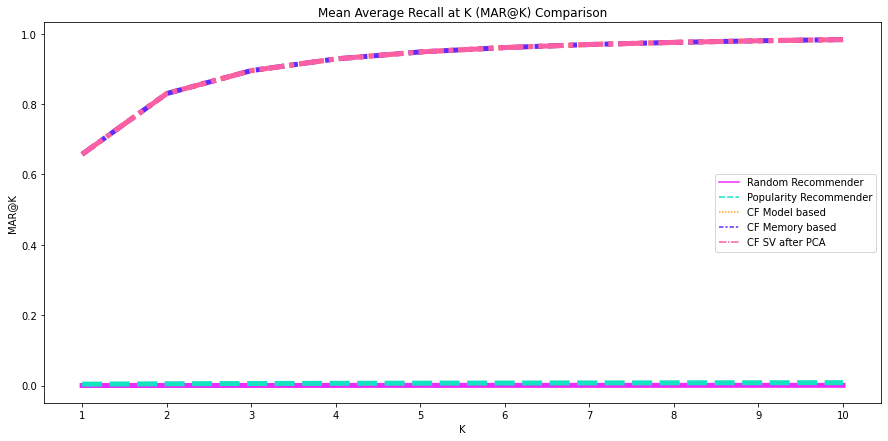

In [87]:
mark_scores = [random_mark, pop_mark, svd_mark, mem_mark, cf_mark]
index = range(1,10+1)
names = ['Random Recommender', 'Popularity Recommender', 'CF Model based', 'CF Memory based', 'CF SV after PCA']

fig = plt.figure(figsize=(15, 7))
recmetrics.mark_plot(mark_scores, model_names=names, k_range=index)

### ------------> OBSERVATION
***
The MAR@K values is quite high since the svd is still calculate the similarity.

## Coverage

In [88]:
cf_coverage = recmetrics.prediction_coverage(cf_recs, catalog)
cf_cat_coverage = recmetrics.catalog_coverage(cf_recs, catalog, 100)

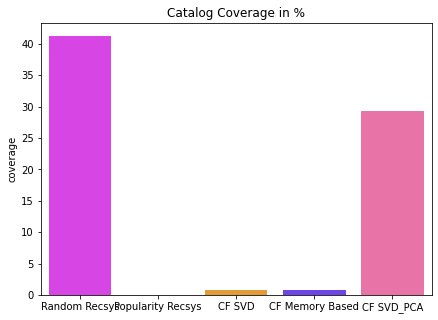

In [89]:
# plot of prediction coverage
coverage_scores = [random_coverage, pop_coverage, svd_cat_coverage, mem_coverage, cf_coverage]
model_names = ['Random Recsys', 'Popularity Recsys', 'CF SVD', 'CF Memory Based', 'CF SVD_PCA']

fig = plt.figure(figsize=(7, 5))
recmetrics.coverage_plot(coverage_scores, model_names)

In [90]:
cf_novelty,cf_mselfinfo_list = recmetrics.novelty(cf_recs, pop, len(users), 10)

## Novelty

In [91]:
print(random_novelty, pop_novelty, svd_novelty, cf_novelty)


9.824257470489515 5.897690888641652 10.18115002708045 10.182873746034884


### ------------> OBSERVATION
***
The Novelty values is still the same

<a id="7.7"></a>
# 7.7 Summary:
***

Evaluation process is not a straightforward process of this project so in order to have a good recommender system, we want to evaluate the efficiency of our system based on 3 main points which are ***Similarity, Coverage, and Novelty.***

***
- ***1. Similarity:***

> - ***Collaborative Filtering Memory Base***: 
>> - ***RMSE***: 
>>> - ***User-based CF RMSE***: 6.878500325214696
>>> - ***Item-based CF RMSE***: 6.933613787364209
> - ***Collaborative Filtering Model Base***: 
>> - ***SVD***: 
>>> - ***RMSE***: around 1.6
>>> - ***Recall***: 0.6620689900106926 to 0.9832171592019945
>> - ***SVD with PCA***: 
>>> - ***RMSE***: around 1.6
>>> - ***Recall***: 0.6620689900106926 to 0.9832171592019945
> - ***Population Recommender***: 
>> - ***Recall***: 0.0032476964931878747 to 0.007758860576248155
> - ***Random Recommender***: 
>> - ***Recall***: 0.00021754921513257017 to 0.0007363667500506285
> - ***Hybrid Recommender***: 
>> - ***Recall***: 0.0820300077883452
>> - ***AUC***: 0.86399215
>> - ***Precision***: 0.038148835

- ***2. Coverage:***

> - ***Population Recommender***: 40%
> - ***Random Recommender***: ~0%
> - ***Collaborative Filtering SVD***: ~2%
> - ***Collaborative Filtering Memory Based***: ~3%
> - ***Collaborative Filtering SVD after PCA***: ~30%

- ***3. Novelty:***

> - ***Population Recommender***: 5.897690888641634
> - ***Random Recommender***: 9.82013504032126
> - ***Collaborative Filtering SVD***: 10.938151314535771
> - ***Collaborative Filtering Memory Based***: 10.938151314535771
> - ***Collaborative Filtering SVD after PCA***: 0.937871052413957

****
# Observation:
****

> - After the PCA Process, the SVD performs more effectively in the coverage. So Currently, our most effective model is ***SVD after PCA***.
> - However, we still want to build a Hybrid Model in order to eliminate the disadvantages in Collaborative Filtering, Content-based, Population and Random Recommender.

<a id="8"></a>
<h1 style="color:#ffc0cb;font-size:40px;font-family:Georgia;text-align:center;"><strong> ⚖ 8. Using TruncatedSVD for dimension reduction</strong></h1>

****

<a id="8.1"></a>
# 8.1 Rescale the data:
***
We use robust scaler to rescale the data same as scaling the data in PCA

In [110]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
truncated_data = scaler.fit_transform(prep_pca_data)

<a id="8.2"></a>
# 8.2 Fit Data into TruncatedSVD:
***

In [111]:
from sklearn.decomposition import TruncatedSVD
truncated = TruncatedSVD(n_components=3, n_iter=7, random_state=42)
truncated_svd_data = truncated.fit_transform(truncated_data)
truncated_prep = pd.DataFrame(truncated_svd_data, columns=['C1', 'C2', 'C3'])

<a id="8.2"></a>
# 8.2 Variance of data :
***

In [112]:
total_var = truncated.explained_variance_ratio_.sum() * 100

fig = px.scatter_3d(
    truncated_svd_data, x=0, y=1, z=2, color = prep_pca_data['Age_Range'],
    title=f'Total Explained Variance: {total_var:.2f}%',
    labels={'0': 'Component 1', '1': 'Component 2', '2': 'Component 3'}
)
fig.show()

### ------------> OBSERVATION
***
As can be observe from the graph, the data variance have been reduced to an acceptable value. Additionally, due to the fact that there are multiple features that have been reduced to only 3 components by SVD, the data is still not well separated.

<a id="8.3"></a>
# 8.3 Ingest the data into SVD model:
***

In [113]:
reader = Reader(rating_scale=(1, 10))
data = Dataset.load_from_df(truncated_prep, reader)

In [114]:
trainset_truncated_svd, testset_truncated_svd = train_test_split(data, test_size=0.2)

In [115]:
svd.fit(trainset_truncated_svd)

pred = svd.test(testset_truncated_svd)
pred = pd.DataFrame(pred)
pred.drop("details", inplace=True, axis=1)
pred.columns = ['User_ID', 'ISBN', 'Rating', 'trun_predictions']
pred.head(20)

,User_ID,ISBN,Rating,trun_predictions
0,-0.745396,0.258941,0.063181,1
1,1.760044,0.284887,0.721464,1
2,-0.571326,-0.090688,-0.005959,1
3,0.352105,0.267632,1.418631,1
4,-0.858212,0.033905,0.980021,1
5,0.955342,0.298526,1.197084,1
6,-0.671705,-0.387263,1.308895,1
7,1.570842,2.472881,1.210874,1
8,0.586038,-1.561466,0.183835,1
9,0.090146,0.794030,1.422981,1


### ------------> OBSERVATION
***
As can be observe from the table, the svd prdeiction churnout all of the rating value of 1. This is due to the long tail issue of the dataset,hence, lead to class imbalance.

In [116]:
print("MSE: ", recmetrics.mse(pred.Rating, pred.trun_predictions))
print("RMSE: ", recmetrics.rmse(pred.Rating, pred.trun_predictions))

MSE:  2.0356916536952503
RMSE:  1.4267766656681944


<a id="8.4"></a>
# 8.4 Evaluate and Compare:
***

In [117]:
trun_model = pred.pivot_table(index='User_ID', columns='ISBN', values='trun_predictions').fillna(0)


In [118]:
pred = pred.copy().groupby('User_ID', as_index=False)['ISBN'].agg({'actual': (lambda x: list(set(x)))})


In [119]:
pred = pred.set_index("User_ID")


In [120]:
# make recommendations for all members in the test data
trun_recs = [] = []
for user in pred.index:
    trun_predictions = get_users_predictions(user, 10, trun_model)
    trun_recs.append(trun_predictions)
        
pred['trun_predictions'] = trun_recs
pred.head()

,actual,trun_predictions
User_ID,,
-3.405522,[2.100821974365058],"[2.100821974365058, -3.765399500448815, 0.4653..."
-3.333776,[2.2842098024146584],"[2.2842098024146584, 0.4677087754890021, 0.467..."
-3.323908,[2.0704559032908265],"[2.0704559032908265, -3.765399500448815, 0.466..."
-3.317923,[1.9408141285032134],"[1.9408141285032134, -3.765399500448815, 0.467..."
-3.285100,[1.4260835250645099],"[1.4260835250645099, -3.765399500448815, 0.466..."


## Recall

In [121]:
trun_mark = []
for K in np.arange(1, 11):
    trun_mark.extend([recmetrics.mark(actual, pred['trun_predictions'], k=K)])
trun_mark

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]

### ------------> OBSERVATION
***
The recall values is considerably low.

## MAR@K

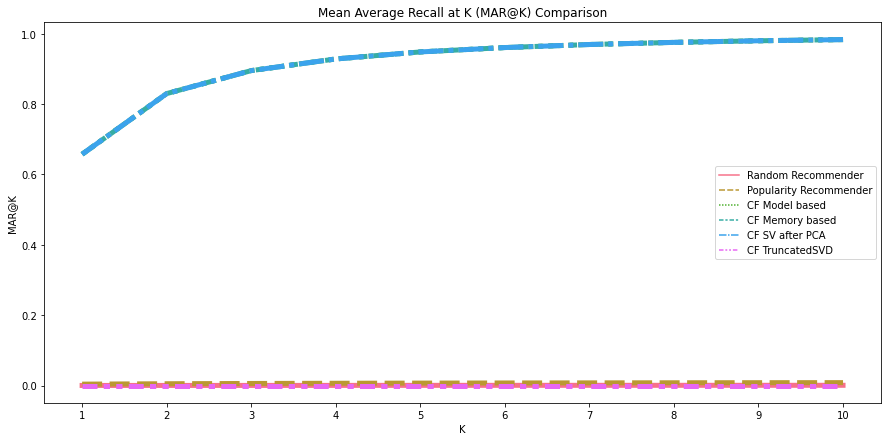

In [122]:
mark_scores = [random_mark, pop_mark, svd_mark, mem_mark, cf_mark, trun_mark]
index = range(1,10+1)
names = ['Random Recommender', 'Popularity Recommender', 'CF Model based', 'CF Memory based', 'CF SV after PCA',
        'CF TruncatedSVD']

fig = plt.figure(figsize=(15, 7))
recmetrics.mark_plot(mark_scores, model_names=names, k_range=index)

### ------------> OBSERVATION
***
The MAR@K values is considerably low.

## Coverage

In [123]:
trun_coverage = recmetrics.prediction_coverage(trun_recs, catalog)
trun_cat_coverage = recmetrics.catalog_coverage(trun_recs, catalog, 100)

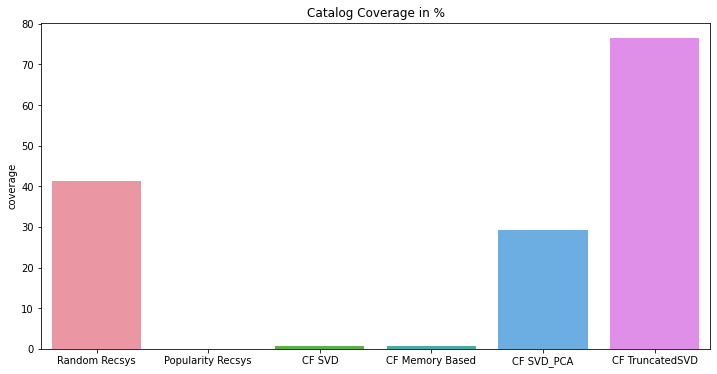

In [140]:
# plot of prediction coverage
coverage_scores = [random_coverage, pop_coverage, svd_cat_coverage, mem_coverage, cf_coverage, trun_coverage]
model_names = ['Random Recsys', 'Popularity Recsys', 'CF SVD', 'CF Memory Based', 'CF SVD_PCA', 'CF TruncatedSVD']

plt.figure(figsize=(12, 6))
recmetrics.coverage_plot(coverage_scores, model_names)

### ------------> OBSERVATION
***
Suprisingly the Coverage of the TruncatedSVD is extremely high.

## Novelty

In [141]:
trun_novelty,cf_mselfinfo_list = recmetrics.novelty(cf_recs, pop, len(users), 10)
print(random_novelty, pop_novelty, svd_novelty, cf_novelty, trun_novelty)


9.824257470489515 5.897690888641652 10.18115002708045 10.182873746034884 10.182873746034884


### ------------> OBSERVATION
***
Suprisingly all the collaborative filtering have the same novelty rate

<a id="8.5"></a>
# 8.5 Summary:
***
- ***1. Similarity:***

> - ***TruncateSVD***: 
>> - ***RMSE***: 1.1698438861550102
>> - ***MSE***: 1.3685347179742566


- ***2. Coverage:***

> - ***Population Recommender***: 40%
> - ***Random Recommender***: ~0%
> - ***Collaborative Filtering SVD***: ~2%
> - ***Collaborative Filtering Memory Based***: ~3%
> - ***Collaborative Filtering SVD after PCA***: ~30%
> - ***Collaborative Filtering TruncatedSVD***: ~80%

- ***3. Novelty:***

> - ***Population Recommender***: 5.897690888641634
> - ***Random Recommender***: 9.82013504032126
> - ***Collaborative Filtering SVD***: 10.938151314535771
> - ***Collaborative Filtering Memory Based***: 10.938151314535771
> - ***Collaborative Filtering SVD after PCA***: 10.182873746034884
> - ***Collaborative Filtering TruncatedSVD***: 10.182873746034884

****
# Observation:
****

> - After the PCA Process, the SVD performs more effectively in the coverage. So Currently, our most effective model is ***SVD after PCA***.
> - However, we still want to build a Hybrid Model in order to eliminate the disadvantages in Collaborative Filtering, Content-based, Population and Random Recommender.